# Investigation the effect of anti-PD1 on T cells

In [1]:
lib = r'/srv01/technion/shitay/Code/classifying_response_to_immunotherapy/'
import sys
sys.path.append(lib)
from utilities.package_importing import *
from statsmodels.stats.weightstats import ztest
import scanpy as sc
import anndata
import warnings 
warnings.filterwarnings("ignore")


In [2]:
### HELPER FUNCTIONS ###

def fraction_test(df_expression, FEATURE, gene, cell_type):
    # return pval
    df_expression['is_expressing'] = df_expression.exp >2.5
    values_in_feature = list(set(df_expression[FEATURE]))
    if len(values_in_feature) < 2:
        print(f'no cells in one of the groups for: {gene}, {cell_type}')
        return 1
    val_1 = values_in_feature[0]
    val_2 = values_in_feature[1]
    
    if len(df_expression[df_expression[FEATURE]==val_1])<=5 or len(df_expression[df_expression[FEATURE]==val_2])<=5:
        return 1
    fractions = df_expression.groupby(['sample', FEATURE])['is_expressing'].agg(['sum', 'count']).reset_index()
    fractions['fractions'] = fractions['sum']/fractions['count']
    statistic, pvalue = ranksums(fractions[fractions[FEATURE]==val_2].fractions, fractions[fractions[FEATURE]==val_1].fractions)
    return pvalue

def Z_TEST(df_expression, FEATURE, gene, cell_type):
    # return pval
    values_in_feature = list(set(df_expression[FEATURE]))
    if len(values_in_feature) < 2:
        print(f'no cells in one of the groups for: {gene}, {cell_type}')
        return 1
    val_1 = values_in_feature[0]
    val_2 = values_in_feature[1]
    
    if len(df_expression[df_expression[FEATURE]==val_1])<=5 or len(df_expression[df_expression[FEATURE]==val_2])<=5:
        return 1
    statistic, pvalue = ztest(res_df[df_expression[FEATURE]==val_1].exp, df_expression[res_df[FEATURE]==val_2].exp, value=0) 
    return pvalue

def fisher_test(df_expression, FEATURE, gene, cell_type):

    df_expression['is_expressing'] = df_expression.exp >2.5
    values_in_feature = list(set(df_expression[FEATURE]))
    if len(values_in_feature) < 2:
        print(f'no cells in one of the groups for: {gene}, {cell_type}')
        return 1
    val_1 = values_in_feature[0]
    val_2 = values_in_feature[1]

    
    if len(df_expression[df_expression[FEATURE]==val_1])<=5 or len(df_expression[df_expression[FEATURE]==val_2])<=5:
        return 1

    n_cells_expressing = df_expression.groupby(FEATURE)['is_expressing'].sum()
    n_cells = df_expression.groupby(FEATURE)['is_expressing'].count()

    R_n_cells_expressing = n_cells_expressing[val_1]
    NR_n_cells_expressing = n_cells_expressing[val_2]
    R_n_cells_not_expressing = n_cells[val_1] - R_n_cells_expressing
    NR_n_cells_not_expressing = n_cells[val_2] - NR_n_cells_expressing

    import scipy.stats as stats
    oddsratio, pvalue = stats.fisher_exact([[R_n_cells_expressing, NR_n_cells_expressing],
                                            [R_n_cells_not_expressing, NR_n_cells_not_expressing]])
    return pvalue

# The rule is * for p<0.05, ** for p<0.005 and *** for p<0.0005.

def get_pval_symbol(p):
    if p<0.0005:
        return '***'
    elif p<0.005:
        return '**'
    elif p<0.05:
        return '*'
    else:
        return ''

# Extract cohort

In [3]:
data_path = r'/storage/md_keren/shitay/Data/smart_seq/SmartSeq_RNAseq_DATA.p'
cells, gene_names, patients_information = extract_smart_seq_data_from_pickle(data_path)

from utilities.smart_seq_dataset import RNAseq_Dataset
cohort = RNAseq_Dataset(cells, patients_information, gene_names)

# Builds gene list

In [4]:
### Prob: TNFA appears as TNF

genes = ['CCR8',  'CXCR3', 'CCL1', 'CXCL11', 'CXCL10', 'CXCL9', 'IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2']
gene_indices = [cohort.gene_names.index(gg) for gg in genes]

In [5]:
from anndata import AnnData
annCohort = AnnData(cohort.cells)

In [6]:
annCohort.var['gene'] = cohort.gene_names

annCohort.obs['sample'] = [cell.patient_details for cell in cohort.cells_information_list] 
annCohort.obs['barcode'] = [cell.cell_id for cell in cohort.cells_information_list] 
annCohort.obs['cell_type'] = [cell.supervised for cell in cohort.cells_information_list] 
annCohort.obs['response'] = [cell.response for cell in cohort.cells_information_list] 
annCohort.obs['pre/post'] = [p.split('_')[0] for p in annCohort.obs['sample'].values.tolist()]

14.12.21 update - last meeting with Nathi, he said that it might be that our definition of DC is slighly different than the definition in Luster's paper and therefore we would like to add those cells to our list.
We will look at cells that express CD103 (ITGAE), and simply call them CD103+:

In [7]:
### Mark cells as CD103+ is they express CD103
MIN_EXP_THRESHOLD = 2.5
CD103_index = annCohort.var.gene.tolist().index('ITGAE') #.index('CD103')
annCohort.obs['CD103+'] = annCohort.X[:,CD103_index] > MIN_EXP_THRESHOLD

### Mark cells as myeloid if their cell type is myeloid
MYELOID_CELL_TYPES = ['Macrophage_immature', 'Macrophage_mature', 'Monocyte_immature', 'Monocyte_mature', 'cDCs_dendritic_cells', 
 'pDCs', 'myeloid cells_general_immature', 'myeloid cells_general_mature', 'Neutrophils', 'Granolocytes']
def is_overlap(l1 , l2):
    return len([f for f in l1 if f in l2])!=0
annCohort.obs['is_myeloid'] = annCohort.obs['cell_type'].apply(lambda x: is_overlap(x, MYELOID_CELL_TYPES))


### Update cell type list
def add_pos_CD103_in_df(x):
    if x['CD103+'] and x['is_myeloid']:
        return x['cell_type'] + ['CD103+']
    else:
        return x['cell_type'] 

annCohort.obs['cell_type'] = annCohort.obs.apply(lambda x: add_pos_CD103_in_df(x), axis=1)

Takes interesting cell types

In [8]:
cell_types = list(set(flatten_list(annCohort.obs['cell_type'].tolist())))
t_cell_types = [ct for ct in cell_types if 'T' in ct]
not_t_cell_types = [ct for ct in cell_types if not ct in t_cell_types]

# Part 1: statiscal tests of cell-types expressing different genes

#### Plots all genes all cell types (T lineage)

Specify statistical test:

In [9]:
TEST_NAME = 'FISHER' # FRACTION/Z/FISHER


if TEST_NAME=='FRACTION':
    stat_test = fraction_test
elif TEST_NAME=='Z':
    stat_test = Z_TEST
elif TEST_NAME=='FISHER':
    stat_test = fisher_test
else:
    raise Exception('statistical name is not valid, change it')


Specify feature of intereset (R vs NR or pre vs post):

In [10]:
FEATURE = 'pre/post' # "response" or "pre/post"

For the other feature (response/biopsy time) that you didn't perform the comparison on, 
if you want to filter only R/NR if you chose to compare biopsy time or alternatively to filter only pre/post if you chose response
you can do it here by setting the value of the variable filter_type:

None - will not filter.

1 - 'Responder'/'Pre' (will take 'Responder' if you compare biopsy time, and will take 'Pre' if you compare between response) 

2 - 'Non-Responder'/'Post' (will take 'Non-responder' if you compare biopsy time, and will take 'Post' if you compare between response) 


In [11]:
filter_type = None

filter_dic = {'response': {1: 'Responder', 2: 'Non-responder'}, 'pre/post': {1: 'Pre', 2:'Post'}}
filter_feature_dic = {'response': 'pre/post', 'pre/post': 'response'} # take by reverse

filtered_cohort = annCohort
if filter_type:
    FILTER_FEATURE = filter_feature_dic[FEATURE]
    print(f'gonna filter {FILTER_FEATURE}')
    filter_feature_req_value = filter_dic[FILTER_FEATURE][filter_type]
    filtered_cohort = annCohort[annCohort.obs[FILTER_FEATURE] == filter_feature_req_value]
    print(f'took only {filter_feature_req_value} samples')

else:
    print(f'did not filter')
print(f'cohort for comparison details:')
print(filtered_cohort)

did not filter
cohort for comparison details:
AnnData object with n_obs × n_vars = 16291 × 20214
    obs: 'sample', 'barcode', 'cell_type', 'response', 'pre/post', 'CD103+', 'is_myeloid'
    var: 'gene'


Specify whether you want to test T cells all all other cell-types:

In [12]:
TO_TEST_T_CELLS = True # True - t cells \ False - not t cells - all other


if TO_TEST_T_CELLS:
    CELL_TYPES = t_cell_types
else:
    CELL_TYPES = not_t_cell_types
    
### Takes only cell types that appear in filted_cohort
CELL_TYPES = [ct for ct in CELL_TYPES if ct in list(set(flatten_list(filtered_cohort.obs['cell_type'].tolist())))]

Conduct statistical tests for all genes X cell-types:

In [13]:
### builds DFs of all genes X cell types and conduct Z test:

df_fractions = pd.DataFrame(columns=['sample', 'response', 'fraction', 'gene', 'cell_type'])
pvals = {}
for gene_idx, gene in enumerate(genes):
    gene_cohort = filtered_cohort[:,  filtered_cohort.var['gene']==gene]
    for idx, cell_type in enumerate(CELL_TYPES):
        cell_type_indices = [cell_type in ttt for ttt in gene_cohort.obs['cell_type']]
        cell_type_cohort = gene_cohort[cell_type_indices, :]
        
        gene_exps = cell_type_cohort.X[:,0].tolist()
        res_df = pd.DataFrame(np.concatenate((cell_type_cohort.obs[['sample', FEATURE]].values.T,[gene_exps])).T, columns=['sample', FEATURE, 'exp'])
        
        ### statistical test of gene expression R/NR
        pvalue = stat_test(res_df, FEATURE, gene, cell_type)
        pvals[(gene, cell_type)] = pvalue
        
        sample_fraction_df = pd.DataFrame(res_df.groupby(['sample', FEATURE]).sum()['is_expressing'] / res_df.groupby('sample').count()['is_expressing']).reset_index().rename(columns={'is_expressing': 'fraction'})
        sample_fraction_df['gene'] = gene
        sample_fraction_df['cell_type'] = cell_type
        df_fractions = df_fractions.append(sample_fraction_df)

# Correct pvals
pvals_arr = np.array([[k, v] for k,v in list(pvals.items())])
corrected_pvals = pvals_arr.copy()
corrected_pvals[:,1] = multipletests_fdr(pvals_arr[:,1])[1].tolist()
corrected_pvals = {pp[0]: pp[1] for pp in corrected_pvals}

# Prints using sns
fig, axs = plt.subplots(len(genes))
fig.set_size_inches(32, 30)
def get_coorected_label(x ,p_value_dic):
    pvalue = p_value_dic[(x['gene'], x['cell_type'])]
    return x['cell_type'] + '\n'+''.join(['*' for sig in [0.05, 0.005, 0.0005] if pvalue < sig])
df_fractions['labeled_cell_type'] = df_fractions.apply(lambda x: get_coorected_label(x, corrected_pvals), axis=1)

hue_order = {'pre/post': [ "Pre", "Post"],
             'response': ["Non-responder", "Responder"]}
for gene_idx, gene in enumerate(genes):
        df_fractions_cur_gene = df_fractions[df_fractions['gene'] == gene]
        sns.boxplot(ax=axs[gene_idx], x='labeled_cell_type', y='fraction', hue=FEATURE, hue_order = hue_order[FEATURE],
                    data=df_fractions_cur_gene, palette={"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"}).set(title=gene);
        sns.stripplot(ax=axs[gene_idx], x='labeled_cell_type', y='fraction', data=df_fractions_cur_gene, hue=FEATURE, hue_order = hue_order[FEATURE],
                  jitter=True, dodge=True, alpha=0.3,linewidth=0.5, palette={"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"});
        if not (gene_idx==0): axs[gene_idx].legend_ = None

if filter_type:
    fig.suptitle(f'Comparing {FEATURE}, only \'{filter_feature_req_value}\' samples were taken, statistical_test={TEST_NAME}', fontsize=32)
else:
    fig.suptitle(f'Comparing {FEATURE}, statistical_test={TEST_NAME}', fontsize=32)
fig.tight_layout(rect=[0, 0.03, 1, 0.95])

no cells in one of the groups for: CCR8, Memory CD4_CD8 T cells
no cells in one of the groups for: CXCR3, Memory CD4_CD8 T cells
no cells in one of the groups for: CCL1, Memory CD4_CD8 T cells
no cells in one of the groups for: CXCL11, Memory CD4_CD8 T cells
no cells in one of the groups for: CXCL10, Memory CD4_CD8 T cells
no cells in one of the groups for: CXCL9, Memory CD4_CD8 T cells
no cells in one of the groups for: IFNG, Memory CD4_CD8 T cells
no cells in one of the groups for: TNF, Memory CD4_CD8 T cells
no cells in one of the groups for: GZMB, Memory CD4_CD8 T cells
no cells in one of the groups for: PRF1, Memory CD4_CD8 T cells
no cells in one of the groups for: IL2, Memory CD4_CD8 T cells


Save fig output:

In [232]:
OUTPUT_FOLDER = r'/storage/md_keren/shitay/Nathi_project/differential analysis/14.12.21' 

if TO_TEST_T_CELLS:
    p_folder = 'T_cells'
else: p_folder = 'other_cells'
create_folder(join(OUTPUT_FOLDER, p_folder))

# folder = FEATURE.replace('/', '_').replace('response', 'R_NR')
test_n = TEST_NAME.lower().replace('fraction','ranksum')
feature_converted = FEATURE.replace('/', '_vs_')
file_name = fr'{p_folder.lower()}_{feature_converted}_comparison'
if filter_type:
    file_name += f'_{filter_feature_req_value}_samples'
file_name += f'_{test_n}_test.png'
FULL_OUTPUT_PATH = join(OUTPUT_FOLDER, p_folder, file_name)
print(f'Will be saved in {FULL_OUTPUT_PATH}')
fig.savefig(FULL_OUTPUT_PATH)

Will be saved in /storage/md_keren/shitay/Nathi_project/differential analysis/14.12.21/other_cells/other_cells_response_comparison_fisher_test.png


### You can check specific cases here.
Enter cell-type and gene and see the percentage of cells expressing the gene.

_FEATURE is the feature of the comparison: response or pre/post

use filter_type to filter the other feature you do not use for the comparison:

None - will not filter.

1 - 'Responder'/'Pre' (will take 'Responder' if you compare biopsy time, and will take 'Pre' if you compare between response) 

2 - 'Non-Responder'/'Post' (will take 'Non-responder' if you compare biopsy time, and will take 'Post' if you compare between response) 

In [14]:
gene = 'CXCR3' 
cell_type = 'T cells'
_FEATURE = 'pre/post' # "response" or "pre/post"
filter_type = None

filter_dic = {'response': {1: 'Responder', 2: 'Non-responder'}, 'pre/post': {1: 'Pre', 2:'Post'}}
filter_feature_dic = {'response': 'pre/post', 'pre/post': 'response'} # take by reverse

if filter_type:
    FILTER_FEATURE = filter_feature_dic[_FEATURE]
    print(f'gonna filter {FILTER_FEATURE}')
    filter_feature_req_value = filter_dic[FILTER_FEATURE][filter_type]
    sub_cohort = sub_cohort[sub_cohort.obs[FILTER_FEATURE] == filter_feature_req_value]
    print(f'took only {filter_feature_req_value} samples')

else:
    print(f'no filter was added')
gene_exp_threshold = 2.5
sub_cohort = annCohort
gene_index = sub_cohort.var.gene.tolist().index(gene)
indices = [cell_type in ttt for ttt in annCohort.obs['cell_type']]
gene_exps = sub_cohort.X[:,gene_index] > gene_exp_threshold

dd = pd.DataFrame(transpose_list([sub_cohort.obs[_FEATURE].tolist(), gene_exps, sub_cohort.obs['sample']]), columns=[_FEATURE, 'is_expressing', 'sample'])
v1 = list(set(sub_cohort.obs[_FEATURE]))[0]
v2 = list(set(sub_cohort.obs[_FEATURE]))[1]

print(f'{v1}: ', round(dd[dd[_FEATURE]==v1]['is_expressing'].sum() / dd[dd[_FEATURE]==v1]['is_expressing'].count(), 3), f' of {cell_type} express {gene}')
print(f'{v2}: ', round(dd[dd[_FEATURE]==v2]['is_expressing'].sum() / dd[dd[_FEATURE]==v2]['is_expressing'].count(), 3), f' of {cell_type} express {gene}')
# pd.DataFrame(dd.groupby(['sample', _FEATURE]).sum()['is_expressing'] / dd.groupby('sample').count()['is_expressing']).reset_index().rename(columns={'is_expressing': 'fraction'}).sort_values('fraction')

no filter was added
Pre:  0.267  of T cells express CXCR3
Post:  0.318  of T cells express CXCR3


# Part 2: tSNE of gene expression and cell-types
tSNE of requested genes and CD8\4 presentation

In [15]:
my_df = pd.DataFrame(cohort.cells, columns=cohort.gene_names)
data = anndata.AnnData(my_df)

In [16]:
sc.tl.pca(data)
sc.pp.neighbors(data)
sc.tl.tsne(data)

In [17]:
# adata.obs.loc[male_patients, 'sex'] = 'male'
CD8 = cohort.cells_information_list.get_cells_belong_to_cells_type('CD8 Cytotoxic T cells')
CD4 = cohort.cells_information_list.get_cells_belong_to_cells_type('CD4 helper T cells')
CD103_pos = ['CD103+' in ff for ff in annCohort.obs.cell_type]
data.obs.loc[CD103_pos, 'CD103+'] = 1
data.obs.loc[CD8, 'CD8 Cytotoxic T cells'] = 1
data.obs.loc[CD4, 'CD4 helper T cells'] = 1

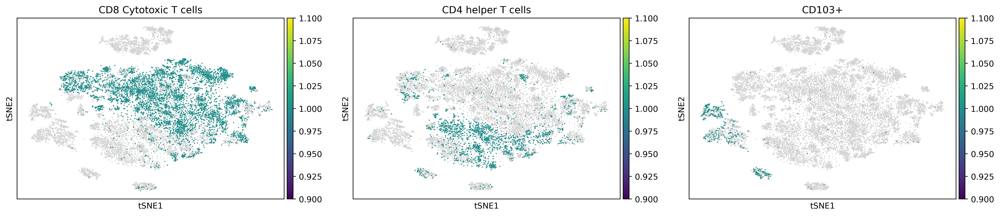

In [18]:
sc.pl.tsne(data, color = ['CD8 Cytotoxic T cells', 'CD4 helper T cells', 'CD103+'])

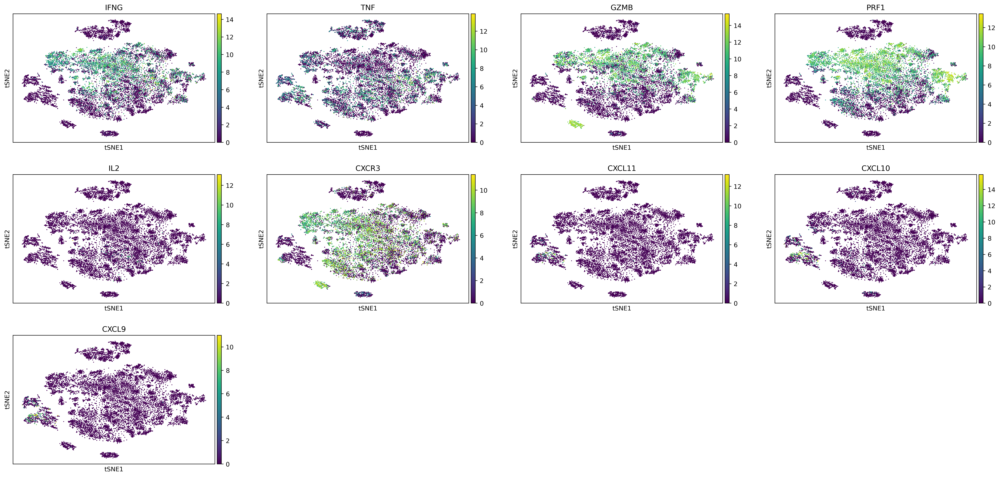

In [19]:
sc.pl.tsne(data, color = ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2', 'CXCR3', 'CXCL11', 'CXCL10', 'CXCL9'])

# Part 3 - use dropletseq to see how tumor cells express CXCR3 ligands

In [19]:
COHORT_PATH = r'/storage/md_keren/shitay/Data/droplet_seq/M97_M173/cohort/normalized/4.11.21/cohort_normalized_4.11.21_protein_coding_genes.pkl'

cohort = pickle.load(open(COHORT_PATH, 'rb'))
tumor_cohort = cohort.filter_cells_by_property('is_cancer', True)

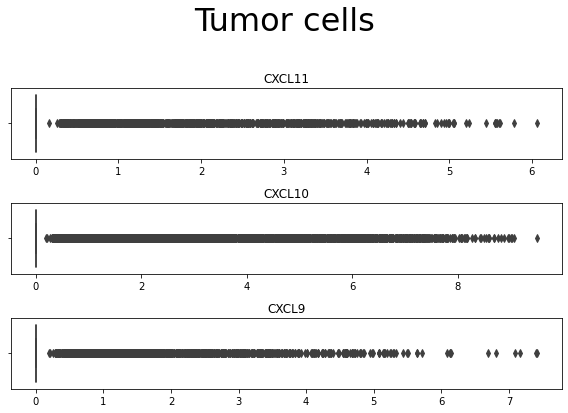

In [145]:
fig, axs = plt.subplots(3)
fig.set_size_inches(8, 6)

sns.reset_orig() # reset size of figure
genes = ['CXCL11', 'CXCL10', 'CXCL9']
for ii, gene in enumerate(genes):
    gene_idx = tumor_cohort.gene_names.index(gene)
    sns.boxplot(tumor_cohort.counts[:, gene_idx], ax=axs[ii]).set(title=gene);

fig.suptitle(f'Tumor cells', fontsize=32)
fig.tight_layout(rect=[0, 0.03, 1, 0.95])

# Part 4 - Treatment affects on CD8/CD4/CXCR3+ cells . 

In [197]:
gene_threshold = 2.5
CXCR3_pos = annCohort.X[:, annCohort.var.gene.tolist().index('CXCR3')] > gene_threshold

In [198]:
# set(flatten_list(annCohort.obs.cell_type))

In [233]:
def watch_anti_PD1_effect(req_cell_types, genes, set_size_inches = (17, 4), output_path=None):
    #################### Builds df of positive expression for cell-type ####################
    gene_threshold = 2.5
    pos_genes_indices = []
    for gene in genes:
        pos_genes_indices.append(annCohort.X[:, annCohort.var.gene.tolist().index(gene)] > gene_threshold)
    response_list = annCohort.obs.response.tolist()
    biopsy_time = annCohort.obs['pre/post'].tolist()
    pos_genes_df = pd.DataFrame(transpose_list([response_list, biopsy_time]+pos_genes_indices), columns=['response', 'biopsy time']+genes)
    #################### add cell-type positive and double poitive to df ####################
    for k, ct in req_cell_types.items():
        pos_genes_df[ct] = [k in ff for ff in annCohort.obs.cell_type]
        for gene in genes:
            pos_genes_df[f'{gene}+'+ct] = pos_genes_df[ct] & pos_genes_df[gene]
    #################### calculate fractions ####################
    # percentage of cell-type out of all cells in group
    fraction_genes_df = pos_genes_df.groupby(['response', 'biopsy time']).sum() / pos_genes_df.groupby(['response', 'biopsy time']).count()
    fraction_genes_df
    for k, ct in req_cell_types.items():
        for gene in genes:
            fraction_genes_df[f'% {gene}+{ct}\n(out of all {ct})'] = fraction_genes_df[f'{gene}+{ct}'] / fraction_genes_df[ct]
    fraction_genes_df.fillna(0, inplace=True)
    #################### plot ####################
    fig, axs = plt.subplots(len(genes), len(req_cell_types))
    axs = axs.ravel()
    fig.set_size_inches(set_size_inches)

    axs_place = {val:idx for idx, val in enumerate([(i,j) for i in range(len(genes)) for j in range(len(req_cell_types))])}
    for g_idx, gene in enumerate(genes):
        for ct_idx, ct in enumerate(req_cell_types.values()):
            pd.pivot_table(fraction_genes_df, values=f'% {gene}+{ct}\n(out of all {ct})',
                           columns=['response', 'biopsy time']).plot(yticks=np.linspace(0, 1, num=11), 
                                                                     kind='bar', ax=axs[axs_place[(g_idx, ct_idx)]],title=f'{gene}+{ct}', alpha=0.75, rot=0);
            axs[axs_place[(g_idx, ct_idx)]].legend(fontsize=9)
            if not (g_idx==0 and ct_idx==len(req_cell_types)-1): axs[axs_place[(g_idx, ct_idx)]].legend_ = None
        axs[axs_place[(g_idx, 0)]].set_ylabel(gene)
    fig.suptitle('anti-PD1 effect', fontsize=16)
    fig.tight_layout(rect=[0, 0.03, 1, 0.95])
    if output_path:
        fig.savefig(output_path)

##### Lymphocytes:

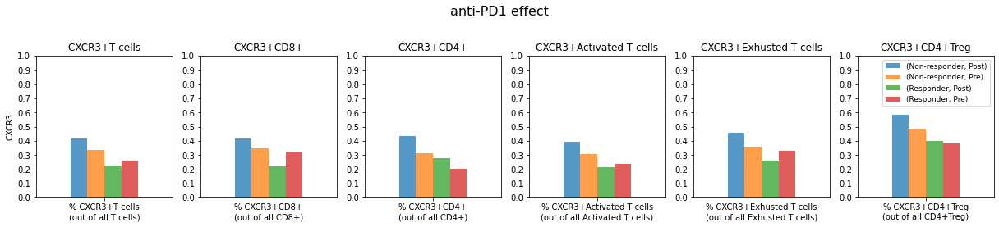

In [234]:
req_cell_types = {'T cells': 'T cells',
                  'CD8 Cytotoxic T cells': 'CD8+',
                 'CD4 helper T cells':'CD4+',
                 'Activated T cells': 'Activated T cells',
                  'Exhausted T cells': 'Exhusted T cells',
                 'Regulatory CD4 T cells': 'CD4+Treg'}
genes = ['CXCR3']
output_path = '/storage/md_keren/shitay/Nathi_project/differential analysis/23.12.21/anti_PD1_t_cells_effect.png'
watch_anti_PD1_effect(req_cell_types, genes, output_path=output_path)

##### Myeloids:

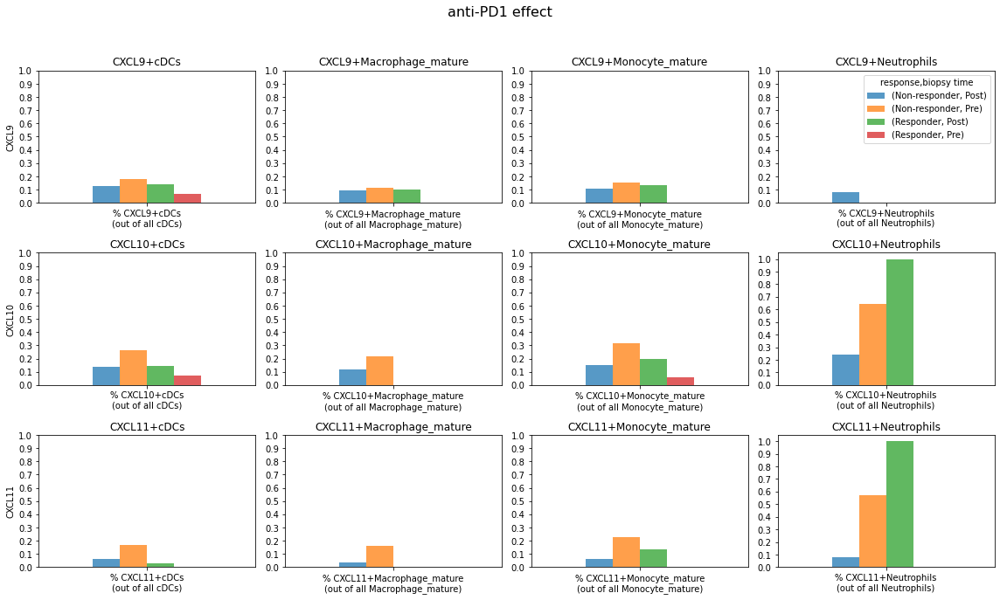

In [201]:
gene_threshold = 2.5

req_cell_types = {'cDCs_dendritic_cells':'cDCs',
                  'Macrophage_mature':'Macrophage_mature',
                  #'B cells':'B cells',
                  'Monocyte_mature':'Monocyte_mature',
                  'Neutrophils': 'Neutrophils'}
genes = ['CXCL9', 'CXCL10', 'CXCL11']
output_path = '/storage/md_keren/shitay/Nathi_project/differential analysis/23.12.21/anti_PD1_effect_on_myeloids.png'
watch_anti_PD1_effect(req_cell_types, genes, (16, 10), output_path=output_path)

##### Part B: How treatment affects expression of 'IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2' in different cell-types:

for 'IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2'
count how many CD8+CXCR3+ cells (in fraction) express all 5 genes, how many express 4, etc. An expression threshold of >2.5. 

In [122]:
gene_expressed_threshold = 2.5
interesting_genes =  ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2']
# interesting_genes =  ['CXCL9', 'CXCL10', 'CXCL11']

gene_indices = [annCohort.var.gene.tolist().index(ii) for ii in interesting_genes]
n_genes_exp = np.sum(annCohort.X[:, gene_indices] > gene_expressed_threshold, axis=1)
CXCR3_df['# cytokines'] = n_genes_exp

for ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2'] count how many CD8+CXCR3+ cells (in fraction) express all 5 genes, how many express 4, etc:


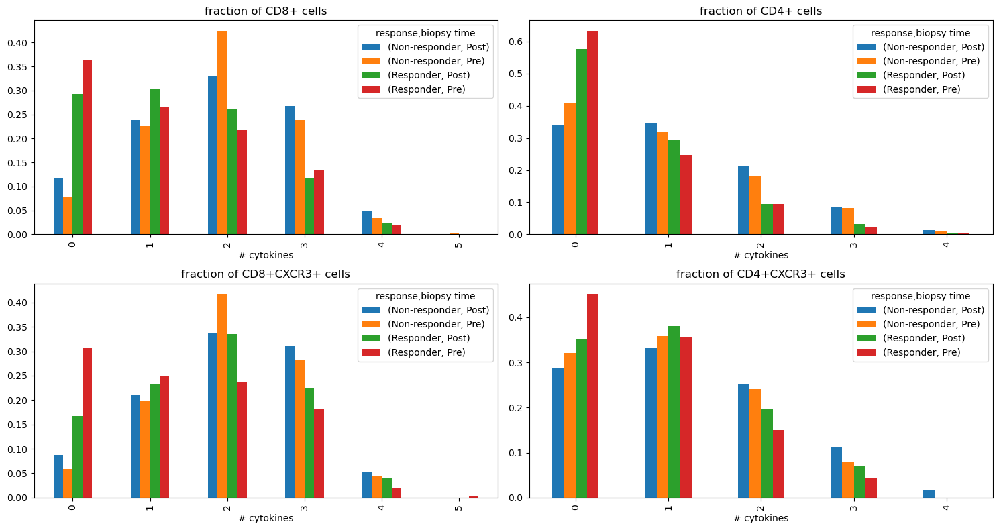

In [123]:
print(bold(f'for {interesting_genes} count how many CD8+CXCR3+ cells (in fraction) express all 5 genes, how many express 4, etc:'))
fig, axs = plt.subplots(2,2)
axs = axs.ravel()
fig.set_size_inches(15, 8)
cell_types_to_examine = ['CD8+', 'CD4+', 'CD8+CXCR3+','CD4+CXCR3+']
for curr_idx, cell_type in enumerate(cell_types_to_examine):
    n_genes_curr_celltype_df = CXCR3_df[CXCR3_df[cell_type]][['response', 'biopsy time', '# cytokines', cell_type]].groupby(['response', 'biopsy time', '# cytokines']).count().rename(columns={cell_type : f'# {cell_type}'})
    count_curr_celltype_CXCR3_df = CXCR3_df.groupby(['response', 'biopsy time']).sum()[[cell_type]]
    def get_num_of_cell_overall(x):
        return count_curr_celltype_CXCR3_df.loc[x.name[:2]].values[0]
    n_genes_curr_celltype_df['# total'] = n_genes_curr_celltype_df.apply(lambda x: get_num_of_cell_overall(x), axis=1)
    n_genes_curr_celltype_df['fraction'] = n_genes_curr_celltype_df[f'# {cell_type}'] / n_genes_curr_celltype_df['# total']
    pd.pivot_table(n_genes_curr_celltype_df[['fraction']].reset_index(), values='fraction', index=['# cytokines'],
                    columns=['response', 'biopsy time'], fill_value=0).plot(kind = 'bar',ax=axs[curr_idx], title=f'fraction of {cell_type} cells');
# axs[-1].remove()
fig.tight_layout()

# Part 5 - fraction of cells expressing the ligands (for all cell-types) 

To see if it is actually that myeloids are those to express the ligands

In [9]:
# ligands = ['CXCL9', 'CXCL10', 'CXCL11']
ligands = ['CXCR3', 'CXCL9', 'CXCL10', 'CXCL11']
gene_expressed_threshold = 2.5

fig, axs = plt.subplots(len(ligands),1)
fig.set_size_inches(25, 4*len(ligands))

all_cell_types = list(set(flatten_list(annCohort.obs.cell_type)))

for lig_idx, ligand in enumerate(ligands):
    p_df = pd.DataFrame(columns=['cell_type', '% expressing'])
    for cell_type in all_cell_types:
        ligand_idx = annCohort.var.gene.tolist().index(ligand)
        cell_type_indices = [cell_type in ff for ff in annCohort.obs.cell_type]
        cell_type_expressing_percent = sum(annCohort.X[cell_type_indices, ligand_idx] > gene_expressed_threshold) / sum(cell_type_indices)
        p_df = p_df.append(pd.DataFrame([[cell_type, cell_type_expressing_percent]],columns=p_df.columns))
        
    sns.reset_orig() # reset size of figure
    sns.set(rc={'figure.figsize':(60.7,8.27)})
    p_df['cell_type'] = p_df['cell_type'].apply(lambda x: x.replace(' ', '\n').replace('_', '\n'))
    p_df['% expressing'] = p_df['% expressing']*100
    sns.barplot(y='% expressing', x='cell_type', data=p_df[p_df['% expressing']>0].sort_values(['% expressing']),palette='GnBu_d', ax=axs[lig_idx]).set(title=ligand);
#     axs[lig_idx].set_yticks([0,0.2, 0.8,40])


fig.tight_layout()

In [92]:
OUTPUT_FILE = fr'/storage/md_keren/shitay/Nathi_project/differential analysis/20.12.21/percent_cell_type_expressing_ligands.png'
fig.savefig(OUTPUT_FILE)

# Debug

In [58]:
# {val:idx for idx, val in enumerate([(i,j) for i in range(len(req_cell_types)) for j in range(len(genes))])}

CXCR3     CXCL9    CXCL10    CXCL11   T cells  \
response      biopsy time                                                     
Non-responder Post         0.362041  0.015019  0.020734  0.006911  0.603801   
              Pre          0.304714  0.016547  0.039026  0.019045  0.674056   
Responder     Post         0.199718  0.004931  0.007045  0.001057  0.523776   
              Pre          0.221651  0.001835  0.002569  0.000000  0.660917   

                           CXCR3+T cells  CXCL9+T cells  CXCL10+T cells  \
response      biopsy time                                                 
Non-responder Post              0.250930       0.001063        0.002658   
              Pre               0.225726       0.000000        0.006244   
Responder     Post              0.118704       0.000704        0.001761   
              Pre               0.174312       0.000367        0.000734   

                           CXCL11+T cells      CD8+  ...  \
response      biopsy time                            ...   
Non-responder Post               0.000266  0.377990  ...   
              Pre                0.000312  0.454886  ...   
Responder     Post               0.000000  0.360338  ...   
              Pre                0.000000  0.376514  ...   

                           % CXCL10+B cells (out of all B cells)  \
response      biopsy time                                          
Non-responder Post                                      0.014831   
              Pre                                       0.067039   
Responder     Post                                      0.001745   
              Pre                                       0.000000   

                           % CXCL11+B cells (out of all B cells)  \
response      biopsy time                                          
Non-responder Post                                      0.002119   
              Pre                                       0.000000   
Responder     Post                                      0.000000   
              Pre                                       0.000000   

                           % CXCR3+Monocyte_mature (out of all Monocyte_mature)  \
response      biopsy time                                                         
Non-responder Post                                                  0.011111      
              Pre                                                   0.000000      
Responder     Post                                                  0.000000      
              Pre                                                   0.000000      

                           % CXCL9+Monocyte_mature (out of all Monocyte_mature)  \
response      biopsy time                                                         
Non-responder Post                                                  0.107407      
              Pre                                                   0.156250      
Responder     Post                                                  0.133333      
              Pre                                                   0.000000      

                           % CXCL10+Monocyte_mature (out of all Monocyte_mature)  \
response      biopsy time                                                          
Non-responder Post                                                  0.148148       
              Pre                                                   0.312500       
Responder     Post                                                  0.200000       
              Pre                                                   0.060606       

                           % CXCL11+Monocyte_mature (out of all Monocyte_mature)  \
response      biopsy time                                                          
Non-responder Post                                                  0.061111       
              Pre                                                   0.229167       
Responder     Post                                                  0.133333       
  

In [116]:
axs_place

{(0, 0): 0,
 (0, 1): 1,
 (0, 2): 2,
 (0, 3): 3,
 (0, 4): 4,
 (1, 0): 5,
 (1, 1): 6,
 (1, 2): 7,
 (1, 3): 8,
 (1, 4): 9,
 (2, 0): 10,
 (2, 1): 11,
 (2, 2): 12,
 (2, 3): 13,
 (2, 4): 14}

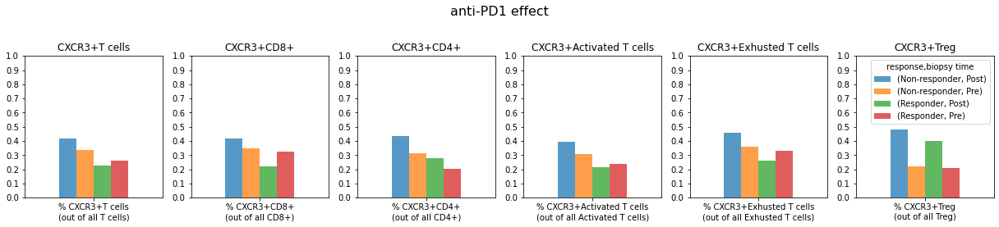

In [145]:

def watch_anti_PD1_effect(req_cell_types, genes, set_size_inches = (17, 4)):
    #################### Builds df of positive expression for cell-type ####################
    gene_threshold = 2.5
    pos_genes_indices = []
    for gene in genes:
        pos_genes_indices.append(annCohort.X[:, annCohort.var.gene.tolist().index(gene)] > gene_threshold)
    response_list = annCohort.obs.response.tolist()
    biopsy_time = annCohort.obs['pre/post'].tolist()
    pos_genes_df = pd.DataFrame(transpose_list([response_list, biopsy_time]+pos_genes_indices), columns=['response', 'biopsy time']+genes)
    #################### add cell-type positive and double poitive to df ####################
    for k, ct in req_cell_types.items():
        pos_genes_df[ct] = [k in ff for ff in annCohort.obs.cell_type]
        for gene in genes:
            pos_genes_df[f'{gene}+'+ct] = pos_genes_df[ct] & pos_genes_df[gene]
    #################### calculate fractions ####################
    # percentage of cell-type out of all cells in group
    fraction_genes_df = pos_genes_df.groupby(['response', 'biopsy time']).sum() / pos_genes_df.groupby(['response', 'biopsy time']).count()
    fraction_genes_df
    for k, ct in req_cell_types.items():
        for gene in genes:
            fraction_genes_df[f'% {gene}+{ct}\n(out of all {ct})'] = fraction_genes_df[f'{gene}+{ct}'] / fraction_genes_df[ct]
    fraction_genes_df.fillna(0, inplace=True)
    #################### plot ####################
    fig, axs = plt.subplots(len(genes), len(req_cell_types))
    axs = axs.ravel()
    fig.set_size_inches(set_size_inches)

    axs_place = {val:idx for idx, val in enumerate([(i,j) for i in range(len(genes)) for j in range(len(req_cell_types))])}
    for g_idx, gene in enumerate(genes):
        for ct_idx, ct in enumerate(req_cell_types.values()):
            pd.pivot_table(fraction_genes_df, values=f'% {gene}+{ct}\n(out of all {ct})',
                           columns=['response', 'biopsy time']).plot(yticks=np.linspace(0, 1, num=11), 
                                                                     kind='bar', ax=axs[axs_place[(g_idx, ct_idx)]],title=f'{gene}+{ct}', alpha=0.75, rot=0);
            if not (g_idx==0 and ct_idx==len(req_cell_types)-1): axs[axs_place[(g_idx, ct_idx)]].legend_ = None
    fig.suptitle('anti-PD1 effect', fontsize=16)
    fig.tight_layout(rect=[0, 0.03, 1, 0.95])
    

# req_cell_types = {'cDCs_dendritic_cells':'cDCs',
#                   'Macrophage_mature':'Macrophage_mature',
#                   'B cells':'B cells',
#                   'Monocyte_mature':'Monocyte_mature',
#                   'Neutrophils': 'Neutrophils'}
req_cell_types = {'T cells': 'T cells',
                  'CD8 Cytotoxic T cells': 'CD8+',
                 'CD4 helper T cells':'CD4+',
                 'Activated T cells': 'Activated T cells',
                  'Exhausted T cells': 'Exhusted T cells',
                 'Regulatory T cells': 'Treg'}
genes = ['CXCR3']
watch_anti_PD1_effect(req_cell_types, genes)

In [113]:
# np.linspace(0, 1, num=11)
# set(flatten_list(annCohort.obs.cell_type))

In [132]:
# sns.reset_orig() # reset size of figure
# gene = 'CXCL9'
# v = 'Macrophage_mature' #'Neutrophils'
# # pd.pivot_table(fraction_genes_df, values=f'% {gene}+{v} (out of all {v})', columns=['response', 'biopsy time']).plot(yticks = np.linspace(0, 1, num=11), kind = 'bar', title=f'anti-PD1 effect on {gene}+{v}', alpha=0.75, rot=0);
# pd.pivot_table(fraction_genes_df, values=f'% {gene}+{v} (out of all {v})', columns=['response', 'biopsy time'])
# pd.pivot_table(pos_genes_df, values=v, columns=['response', 'biopsy time'])
# # fraction_genes_df
# sum(pos_genes_df[v])

In [51]:


# if len(req_cell_types)%3>0:
#     for i in range(3-len(req_cell_types)%3, 0, -1):
#         axs[-i].remove()

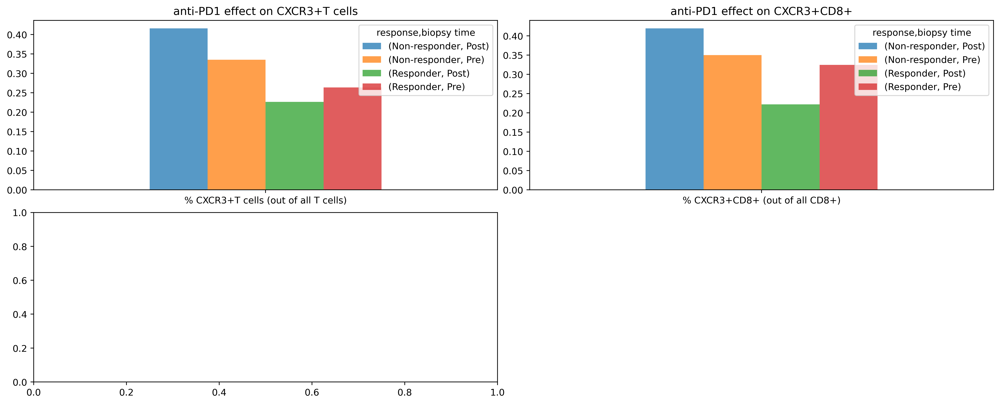

In [17]:
gene_threshold = 2.5
CXCR3_pos = annCohort.X[:, annCohort.var.gene.tolist().index('CXCR3')] > gene_threshold

req_cell_types = {'T cells': 'T cells',
                  'CD8 Cytotoxic T cells': 'CD8+'}
#                  'CD4 helper T cells':'CD4+',
#                  'Activated T cells': 'Activated T cells',
#                   'Exhausted T cells': 'Exhusted T cells',
#                  'Regulatory T cells': 'Treg'}


response_list = annCohort.obs.response.tolist()
biopsy_time = annCohort.obs['pre/post'].tolist()
CXCR3_df = pd.DataFrame(transpose_list([response_list, biopsy_time, CXCR3_pos]), columns=['response', 'biopsy time', 'CXCR3'])

for k, v in req_cell_types.items():
    CXCR3_df[v] = [k in ff for ff in annCohort.obs.cell_type]
    CXCR3_df[v+'CXCR3+'] = CXCR3_df[v] & CXCR3_df.CXCR3

fraction_CXCR3_df = CXCR3_df.groupby(['response', 'biopsy time']).sum() / CXCR3_df.groupby(['response', 'biopsy time']).count()
for k, v in req_cell_types.items():
    fraction_CXCR3_df[f'% CXCR3+{v} (out of all {v})'] = fraction_CXCR3_df[v+'CXCR3+'] / fraction_CXCR3_df[v]
    
fig, axs = plt.subplots(2, 3 if len(req_cell_types)>=3 else 2)
axs = axs.ravel()
fig.set_size_inches(15, 6)

for idx, v in enumerate(req_cell_types.values()):
    pd.pivot_table(fraction_CXCR3_df, values=f'% CXCR3+{v} (out of all {v})', columns=['response', 'biopsy time']).plot(kind = 'bar', ax=axs[idx],title=f'anti-PD1 effect on CXCR3+{v}', alpha=0.75, rot=0);
plt.tight_layout(pad=0.4)

if len(req_cell_types)%3>0:
    for i in range(3-len(req_cell_types)%3, 0, -1):
        axs[-i].remove()

33 539


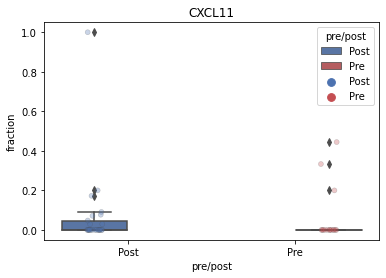

In [71]:
cell_type = all_cell_types[3]
ligand_idx = annCohort.var.gene.tolist().index(ligand)
cell_type_indices = [cell_type in ff for ff in annCohort.obs.cell_type]
cell_type_expressing_percent = sum(annCohort.X[cell_type_indices, ligand_idx] > gene_expressed_threshold) / sum(cell_type_indices)
p_df = p_df.append(pd.DataFrame([[cell_type, cell_type_expressing_percent]],columns=p_df.columns))
print(sum(annCohort.X[cell_type_indices, ligand_idx] > gene_expressed_threshold) , sum(cell_type_indices))


FEATURE = 'pre/post'
res_df = annCohort[cell_type_indices].obs.copy()
res_df['is_expressing'] = annCohort[cell_type_indices].X[:,ligand_idx] > 2.5

res_df.head()
sample_fraction_df.head()

sns.reset_orig() # reset size of figure

sample_fraction_df = pd.DataFrame(res_df.groupby(['sample', FEATURE]).sum()['is_expressing'] / res_df.groupby('sample').count()['is_expressing']).reset_index().rename(columns={'is_expressing': 'fraction'})
# sample_fraction_df.fraction= sample_fraction_df.fraction.astype(float)

sns.boxplot(x=FEATURE, y='fraction', hue=FEATURE,
            data=sample_fraction_df, palette={"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"}).set(title=ligand);
sns.stripplot(x=FEATURE, y='fraction', data=sample_fraction_df, hue=FEATURE,
          jitter=True, dodge=True, alpha=0.3,linewidth=0.5, palette={"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"});

In [313]:
#### removed on 20.12.20, FIG A fraction of CD4+CXCR3+ out of CD4+ (not generic)

# CD8 = ['CD8 Cytotoxic T cells' in ff for ff in annCohort.obs.cell_type]
# CD4 = ['CD4 helper T cells' in ff for ff in annCohort.obs.cell_type]
# response_list = annCohort.obs.response.tolist()
# biopsy_time = annCohort.obs['pre/post'].tolist()
# CXCR3_df = pd.DataFrame(transpose_list([response_list, biopsy_time, CD8, CD4, CXCR3_pos]), columns=['response', 'biopsy time', 'CD8','CD4', 'CXCR3'])


# CXCR3_df['CD8+CXCR3+'] = CXCR3_df.CD8 & CXCR3_df.CXCR3
# CXCR3_df['CD4+CXCR3+'] = CXCR3_df.CD4 & CXCR3_df.CXCR3
# fraction_CXCR3_df = CXCR3_df.groupby(['response', 'biopsy time']).sum() / CXCR3_df.groupby(['response', 'biopsy time']).count()
# fraction_CXCR3_df['% CD8+CXCR3+ (out of all CD8)'] = fraction_CXCR3_df['CD8+CXCR3+'] / fraction_CXCR3_df['CD8']
# fraction_CXCR3_df['% CD4+CXCR3+ (out of all CD4)'] = fraction_CXCR3_df['CD4+CXCR3+'] / fraction_CXCR3_df['CD4']
# fraction_CXCR3_df

# # print(f'Number of cells:')
# # display(CXCR3_df.groupby(['response', 'biopsy time']).count().rename(columns={'CXCR3':'# cells'})[['# cells']])
# # print(f'Number of those cells:')
# # display(CXCR3_df.groupby(['response', 'biopsy time']).sum())
# # print(f'% of these cells in cohort:')
# # display(fraction_CXCR3_df)

# fig, axs = plt.subplots(1,2)
# fig.set_size_inches(15, 4)

# pd.pivot_table(fraction_CXCR3_df, values='% CD8+CXCR3+ (out of all CD8)', columns=['response', 'biopsy time']).plot(kind = 'bar', ax=axs[0],title='anti-PD1 effect on CD8+CXCR3+', alpha=0.75, rot=0);
# pd.pivot_table(fraction_CXCR3_df, values='% CD4+CXCR3+ (out of all CD4)', columns=['response', 'biopsy time']).plot(kind = 'bar', ax=axs[1],title='anti-PD1 effect on CD4+CXCR3+', alpha=0.75, rot=0);

In [224]:
#### removed on 20.12.20, this is the version where plots are boxplot of expression and not fractions


# ### builds DFs of all genes X cell types and conduct Z test:
# df_gene_list = {}
# for gene_idx, gene in enumerate(genes):
#     g_cohort = filtered_cohort[:,  filtered_cohort.var['gene']==gene]
#     f_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', FEATURE])
#     df_gene_list[gene] = []
#     for idx, cell_type in enumerate(CELL_TYPES):
#         indices = [cell_type in ttt for ttt in g_cohort.obs['cell_type']]
#         fg_cohort = g_cohort[indices, :]
#         gene_exps = fg_cohort.X[:,0].tolist()
#         feature_values = fg_cohort.obs[FEATURE].tolist()
#         barcodes = fg_cohort.obs['barcode'].tolist()
#         samples = fg_cohort.obs['sample'].tolist()

#         ### statistical test of gene expression R/NR
#         res_df = pd.DataFrame(transpose_list([samples, feature_values, gene_exps]), columns=['sample', FEATURE, 'exp'])
#         pvalue = stat_test(res_df, FEATURE, gene, cell_type)
    
#         df_gene_list[gene].append([pd.DataFrame(np.array([barcodes, gene_exps, [cell_type]*fg_cohort.shape[0], feature_values]).T, columns=f_df.columns), pvalue])
        
# fig, axs = plt.subplots(len(genes))
# fig.set_size_inches(32, 30)

# ### Correct pvals of all [genes X cell_types]
# corrected_pvals = multipletests_fdr(np.array([pp[1]for ct_dfs in df_gene_list.values() for pp in ct_dfs ]))[1].reshape(len(genes), len(CELL_TYPES))

# ### For each gene prints all cell types:
# my_pal = {"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"}
# for gene_idx, gene in enumerate(genes):
#     print_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', FEATURE])
#     for cell_idx, cell_type in enumerate(CELL_TYPES):
#         cell_type_df = df_gene_list[gene][cell_idx][0]
#         prev_pval = df_gene_list[gene][cell_idx][1]
#         corrected_pval = corrected_pvals[gene_idx][cell_idx]
#         cell_type_df['cell type'] = cell_type_df['cell type'].iloc[0]+'\n'+ get_pval_symbol(corrected_pval)
#         print_df = print_df.append(cell_type_df)

#     print_df['gene expression'] = print_df['gene expression'].astype(float)
#     g = sns.boxplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue=FEATURE, data=print_df, palette=my_pal).set(title=gene)

# if filter_type:
#     fig.suptitle(f'Comparing {FEATURE}, only \'{filter_feature_req_value}\' samples were taken, statistical_test={TEST_NAME}', fontsize=32)
# else:
#     fig.suptitle(f'Comparing {FEATURE}, statistical_test={TEST_NAME}', fontsize=32)
# fig.tight_layout(rect=[0, 0.03, 1, 0.95])

DEBUG:::: Part 3 - See fractions of CD8/CD4 cells (R/NR/ALL) that express one or more genes from ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2']
Fraction of cells expressing 1/2/3/4/5 genes from the gene list

In [16]:
gene_expressed_threshold = 2.5

In [17]:
CD8 = cohort.cells_information_list.get_cells_belong_to_cells_type('CD8 Cytotoxic T cells')
CD4 = cohort.cells_information_list.get_cells_belong_to_cells_type('CD4 helper T cells')

In [18]:
interesting_genes =  ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2']
gene_indices = [cohort.gene_names.index(ii) for ii in interesting_genes]

##### See fractions of CD8 R/NR/ALL that express one or more genes from ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2']

In [25]:
### CD8
CD8_filtered_genes = cohort.cells[CD8][:,gene_indices]
n_of_CD8_cells = len(CD8_filtered_genes)
fractions = dict(Counter((CD8_filtered_genes > gene_expressed_threshold).sum(axis=1)))
fractions = sort_dic({k: round(v/n_of_CD8_cells,4) for k,v in fractions.items()})
for i in range(6):
    fractions.setdefault(i, 0)
CD8_df = pd.DataFrame(({k: [v] for k,v in fractions.items()})).T.rename(columns={0:'CD8 Cytotoxic T cells'})


### CD8 responder
responder_patients = [cc.response_label==1 for cc in cohort.cells_information_list]
CD8_responder_filtered_genes = cohort.cells[np.array(responder_patients) & np.array(CD8)][:,gene_indices]
n_of_CD8_responder_cells = len(CD8_responder_filtered_genes)
fractions = dict(Counter((CD8_responder_filtered_genes > gene_expressed_threshold).sum(axis=1)))
fractions = sort_dic({k: round(v/n_of_CD8_responder_cells,4) for k,v in fractions.items()})
for i in range(6):
    fractions.setdefault(i, 0)
CD8_responder_df = pd.DataFrame(({k: [v] for k,v in fractions.items()})).T.rename(columns={0:'Responder - CD8 Cytotoxic T cells'})

### CD8 non-responder
non_responder_patients = [cc.response_label==0 for cc in cohort.cells_information_list]
CD8_non_responder_filtered_genes = cohort.cells[np.array(non_responder_patients) & np.array(CD8)][:,gene_indices]
n_of_CD8_non_responder_cells = len(CD8_non_responder_filtered_genes)
fractions = dict(Counter((CD8_non_responder_filtered_genes > gene_expressed_threshold).sum(axis=1)))
fractions = sort_dic({k: round(v/n_of_CD8_non_responder_cells,4) for k,v in fractions.items()})
for i in range(6):
    fractions.setdefault(i, 0)
CD8_non_responder_df = pd.DataFrame(({k: [v] for k,v in fractions.items()})).T.rename(columns={0:'Non responder - CD8 Cytotoxic T cells'})

CD8_fractions = pd.concat([CD8_df, CD8_non_responder_df, CD8_responder_df], axis=1)
CD8_fractions['# genes that are expressed'] = CD8_fractions.index.tolist()
CD8_fractions = CD8_fractions[['# genes that are expressed', 'CD8 Cytotoxic T cells', 'Responder - CD8 Cytotoxic T cells', 'Non responder - CD8 Cytotoxic T cells']]
CD8_fractions

,# genes that are expressed,CD8 Cytotoxic T cells,Responder - CD8 Cytotoxic T cells,Non responder - CD8 Cytotoxic T cells
0,0,0.1756,0.3280,0.1030
1,1,0.2499,0.2836,0.2339
2,2,0.3224,0.2396,0.3618
3,3,0.2153,0.1264,0.2576
4,4,0.0364,0.0220,0.0432
5,5,0.0005,0.0005,0.0005


In [ ]:
CD8_fractions.to_excel(r'/storage/md_keren/shitay/Nathi_project/CD8_fractions.xlsx', index = False)

##### See fractions of CD4 R/NR/ALL that express one or more genes in ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2']

In [27]:
CD4_filtered_genes = cohort.cells[CD4][:,gene_indices]
n_of_CD4_cells = len(CD4_filtered_genes)
fractions = dict(Counter((CD4_filtered_genes > gene_expressed_threshold).sum(axis=1)))
fractions = sort_dic({k: round(v/n_of_CD4_cells,4) for k,v in fractions.items()})
for i in range(6):
    fractions.setdefault(i, 0)
CD4_df = pd.DataFrame(({k: [v] for k,v in fractions.items()})).T.rename(columns={0:'CD4 helper T cells'})

### CD4 responder
responder_patients = [cc.response_label==1 for cc in cohort.cells_information_list]
CD4_responder_filtered_genes = cohort.cells[np.array(responder_patients) & np.array(CD4)][:,gene_indices]
n_of_CD4_responder_cells = len(CD4_responder_filtered_genes)
fractions = dict(Counter((CD4_responder_filtered_genes > gene_expressed_threshold).sum(axis=1)))
fractions = sort_dic({k: round(v/n_of_CD4_responder_cells,4) for k,v in fractions.items()})
for i in range(6):
    fractions.setdefault(i, 0)
CD4_responder_df = pd.DataFrame(({k: [v] for k,v in fractions.items()})).T.rename(columns={0:'Responder - CD4 helper T cells'})

### CD4 non-responder
non_responder_patients = [cc.response_label==0 for cc in cohort.cells_information_list]
CD4_non_responder_filtered_genes = cohort.cells[np.array(non_responder_patients) & np.array(CD4)][:,gene_indices]
n_of_CD4_non_responder_cells = len(CD4_non_responder_filtered_genes)
fractions = dict(Counter((CD4_non_responder_filtered_genes > gene_expressed_threshold).sum(axis=1)))
fractions = sort_dic({k: round(v/n_of_CD4_non_responder_cells,4) for k,v in fractions.items()})
for i in range(6):
    fractions.setdefault(i, 0)
CD4_non_responder_df = pd.DataFrame(({k: [v] for k,v in fractions.items()})).T.rename(columns={0:'Non responder - CD4 helper T cells'})


CD4_fractions = pd.concat([CD4_df, CD4_non_responder_df, CD4_responder_df], axis=1)
CD4_fractions['# genes that are expressed'] = CD4_fractions.index.tolist()
CD4_fractions = CD4_fractions[['# genes that are expressed', 'CD4 helper T cells', 'Responder - CD4 helper T cells', 'Non responder - CD4 helper T cells']]
CD4_fractions

,# genes that are expressed,CD4 helper T cells,Responder - CD4 helper T cells,Non responder - CD4 helper T cells
0,0,0.4413,0.6136,0.3599
1,1,0.3142,0.2628,0.3385
2,2,0.1680,0.0952,0.2024
3,3,0.0665,0.0256,0.0858
4,4,0.0100,0.0028,0.0134
5,5,0.0000,0.0000,0.0000


In [255]:
CD4_fractions.to_excel(r'/storage/md_keren/shitay/Nathi_project/CD4_fractions.xlsx', index = False)

# Debug

for ['IFNG', 'TNF', 'GZMB', 'PRF1', 'IL2'] count how many CD8+CXCR3+ cells (in fraction) express all 5 genes, how many express 4, etc:


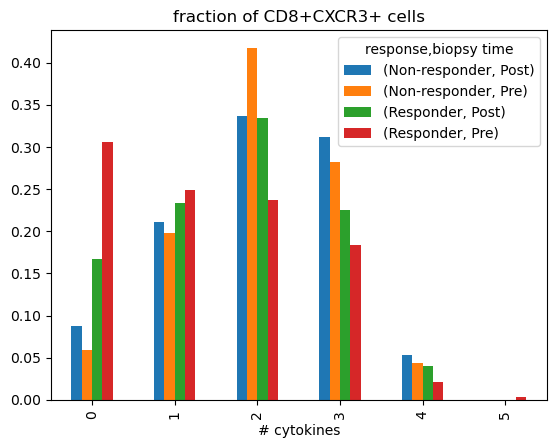

In [348]:
n_genes_CD8CXCR3_df = CXCR3_df[CXCR3_df['CD8+CXCR3+']][['response', 'biopsy time', '# cytokines', 'CD8+CXCR3+']].groupby(['response', 'biopsy time', '# cytokines']).count().rename(columns={'CD8+CXCR3+' : '# CD8+CXCR3+'})
count_CD8_CXCR3_df = CXCR3_df.groupby(['response', 'biopsy time']).sum()[['CD8+CXCR3+']]
def get_num_of_cell_overall(x):
    return count_CD8_CXCR3_df.loc[x.name[:2]].values[0]
n_genes_CD8CXCR3_df['# total'] = n_genes_CD8CXCR3_df.apply(lambda x: get_num_of_cell_overall(x), axis=1)
n_genes_CD8CXCR3_df['fraction'] = n_genes_CD8CXCR3_df['# CD8+CXCR3+'] / n_genes_CD8CXCR3_df['# total']
print(f'for {interesting_genes} count how many CD8+CXCR3+ cells (in fraction) express all 5 genes, how many express 4, etc:')

plt.rcdefaults()  
pd.pivot_table(n_genes_CD8CXCR3_df[['fraction']].reset_index(), values='fraction', index=['# cytokines'],
                    columns=['response', 'biopsy time'], fill_value=0).plot(kind = 'bar', title='fraction of CD8+CXCR3+ cells');

In [27]:
# ddd = pickle.load(open(r'/storage/md_keren/shitay/Data/smart_seq/patients_divisions/all_test0.3_ver2.p', 'rb'))
# len(ddd)

In [12]:
gene = 'CXCL10'
cell_type = 'Neutrophils'

g_cohort = annCohort[:,  annCohort.var['gene']==gene]
f_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', FEATURE])
indices = [cell_type in ttt for ttt in g_cohort.obs['cell_type']]
fg_cohort = g_cohort[indices, :]
gene_exps = fg_cohort.X[:,0].tolist()
feature_values = fg_cohort.obs[FEATURE].tolist()
samples = fg_cohort.obs['sample'].tolist()

### statistical test of gene expression R/NR
res_df = pd.DataFrame(transpose_list([samples, feature_values, gene_exps]), columns=['sample', FEATURE, 'exp'])
pvalue = stat_test(res_df, FEATURE, gene, cell_type)

pvalue


0.2967175263220605

In [45]:
def fraction_test(df_expression):
    # return pval
    if len(df_expression[df_expression.response=='Responder'])<=5 or len(df_expression[df_expression.response=='Non-responder'])<=5:
        return 1
    df_expression['is_expressing'] = df_expression.exp >2.5
    fractions = df_expression.groupby(['sample', 'response'])['is_expressing'].agg(['sum', 'count']).reset_index()
    fractions['fractions'] = fractions['sum']/fractions['count']
    statistic, pvalue = ranksums(fractions[fractions['response']=='Non-responder'].fractions, fractions[fractions['response']=='Responder'].fractions)
    return pvalue



In [26]:
# # The rule is * for p<0.05, ** for p<0.005 and *** for p<0.0005.

# def get_pval_symbol(p):
#     if p<0.0005:
#         return '***'
#     elif p<0.005:
#         return '**'
#     elif p<0.05:
#         return '*'
#     else:
#         return ''

# ### builds DFs of all genes X cell types and conduct Z test:
# df_gene_list = {}
# for gene_idx, gene in enumerate(genes):
#     g_cohort = annCohort[:,  annCohort.var['gene']==gene]
#     f_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', 'Response'])
#     df_gene_list[gene] = []
#     for idx, cell_type in enumerate(cell_types):
#         indices = [cell_type in ttt for ttt in g_cohort.obs['cell_type']]
#         fg_cohort = g_cohort[indices, :]
#         gene_exps = fg_cohort.X[:,0].tolist()
#         responses = fg_cohort.obs['response'].tolist()
#         barcodes = fg_cohort.obs['barcode'].tolist()
#         samples = fg_cohort.obs['sample'].tolist()
        
#         ### ztest on gene expression R/NR
#         res_df = pd.DataFrame(transpose_list([samples, responses, gene_exps]), columns=['sample', 'response', 'exp'])
#         pvalue = stat_test(res_df)
    
#         df_gene_list[gene].append([pd.DataFrame(np.array([barcodes, gene_exps, [cell_type]*fg_cohort.shape[0], responses]).T, columns=f_df.columns), pvalue])
        
# fig, axs = plt.subplots(len(genes))
# fig.set_size_inches(32, 30)

# ### Correct pvals of all [genes X cell_types]
# corrected_pvals = multipletests_fdr(np.array([pp[1]for ct_dfs in df_gene_list.values() for pp in ct_dfs ]))[1].reshape(len(genes), len(cell_types))

# ### For each gene prints all cell types:
# for gene_idx, gene in enumerate(genes):
#     print_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', 'Response'])
#     for cell_idx, cell_type in enumerate(cell_types):
#         cell_type_df = df_gene_list[gene][cell_idx][0]
#         prev_pval = df_gene_list[gene][cell_idx][1]
#         corrected_pval = corrected_pvals[gene_idx][cell_idx]
#         cell_type_df['cell type'] = cell_type_df['cell type'].iloc[0]+'\n'+ get_pval_symbol(corrected_pval)
#         print_df = print_df.append(cell_type_df)

#     print_df['gene expression'] = print_df['gene expression'].astype(float)
#     g = sns.boxplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue='Response', data=print_df, palette="Set1").set(title=gene)

# plt.tight_layout(pad=0.2)

In [ ]:
########################## WITHOUT Z TEST ON GENE EXPRESSION ##########################

# fig, axs = plt.subplots(len(genes))
# fig.set_size_inches(28, 30)


# for gene_idx, gene in enumerate(genes):
#     g_cohort = annCohort[:,  annCohort.var['gene']==gene]
#     df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', 'Response'])
#     for idx, cell_type in enumerate(cell_types):
#         indices = [cell_type in ttt for ttt in g_cohort.obs['cell_type']]
#         fg_cohort = g_cohort[indices, :]
#         gene_exps = fg_cohort.X[:,0].tolist()
#         responses = fg_cohort.obs['response'].tolist()
#         barcodes = fg_cohort.obs['barcode'].tolist()
#         df = df.append(pd.DataFrame(np.array([barcodes, gene_exps, [cell_type]*fg_cohort.shape[0], responses]).T, columns=df.columns))
#     df['gene expression'] = df['gene expression'].astype(float)
#     g = sns.boxplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue='Response', data=df, palette="Set1").set(title=gene)

# plt.tight_layout(pad=0.2)




In [116]:
########################## Z test without pvals corrections ##########################

# fig, axs = plt.subplots(len(genes))
# fig.set_size_inches(32, 30)

# def get_pval_symbol(p):
#     if p<0.0005:
#         return '***'
#     elif p<0.005:
#         return '**'
#     elif p<0.05:
#         return '*'
#     else:
#         return ''

# for gene_idx, gene in enumerate(genes):
#     g_cohort = annCohort[:,  annCohort.var['gene']==gene]
#     df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', 'Response'])
#     for idx, cell_type in enumerate(cell_types):
#         indices = [cell_type in ttt for ttt in g_cohort.obs['cell_type']]
#         fg_cohort = g_cohort[indices, :]
#         gene_exps = fg_cohort.X[:,0].tolist()
#         responses = fg_cohort.obs['response'].tolist()
#         barcodes = fg_cohort.obs['barcode'].tolist()
        
#         ### ztest on gene expression R/NR
#         res_df = pd.DataFrame(transpose_list([responses, gene_exps]), columns=['response', 'exp'])
#         if len(res_df[res_df.response=='Responder'])>5 and len(res_df[res_df.response=='Non-responder'])>5:
#             statistic, pvalue = ztest(res_df[res_df.response=='Responder'].exp, res_df[res_df.response=='Non-responder'].exp, value=0) 
#         else:
#             pvalue = 1
#         pval_sym = get_pval_symbol(pvalue)
    
#         df = df.append(pd.DataFrame(np.array([barcodes, gene_exps, [cell_type+'\n'+pval_sym]*fg_cohort.shape[0], responses]).T, columns=df.columns))
        
#     df['gene expression'] = df['gene expression'].astype(float)
#     g = sns.boxplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue='Response', data=df, palette="Set1").set(title=gene)

# plt.tight_layout(pad=0.2)

In [22]:
df_gene_list[gene] = []
for idx, cell_type in enumerate(CELL_TYPES):
        indices = [cell_type in ttt for ttt in g_cohort.obs['cell_type']]
        fg_cohort = g_cohort[indices, :]
        gene_exps = fg_cohort.X[:,0].tolist()
        feature_values = fg_cohort.obs[FEATURE].tolist()
        barcodes = fg_cohort.obs['barcode'].tolist()
        samples = fg_cohort.obs['sample'].tolist()

        ### statistical test of gene expression R/NR
        res_df = pd.DataFrame(transpose_list([samples, feature_values, gene_exps]), columns=['sample', FEATURE, 'exp'])
        pvalue = stat_test(res_df, FEATURE, gene, cell_type)
    
        df_gene_list[gene].append([pd.DataFrame(np.array([barcodes, gene_exps, [cell_type]*fg_cohort.shape[0], feature_values]).T, columns=f_df.columns), pvalue])
        
# df_gene_list

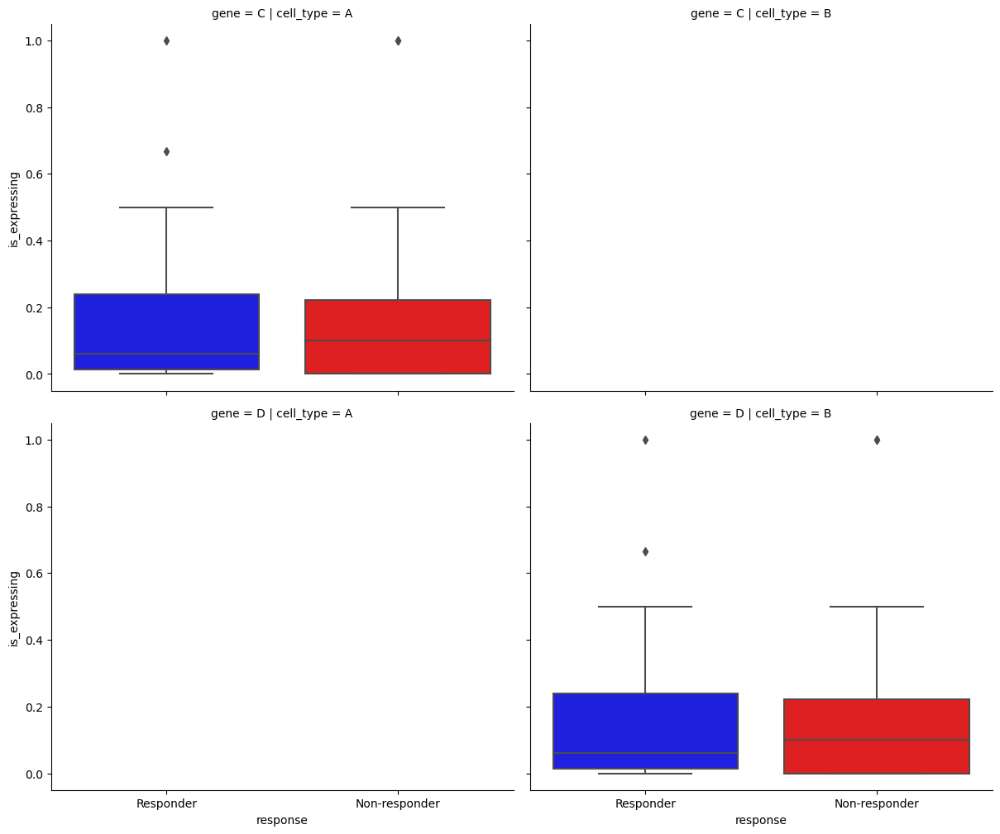

In [137]:
# sample_fraction_df['cell_type'] = 
ddd = sample_fraction_df.append(sample_fraction_df)
ddd['cell_type'] = ['A']*len(sample_fraction_df) + ['B']*len(sample_fraction_df)
ddd['gene'] = ['C']*int(len(sample_fraction_df)) + ['D']*int(len(sample_fraction_df))
# ddd
sns.catplot(x="response", y="is_expressing", col='cell_type', row='gene', data=ddd, kind="box",height=5, palette=my_pal, aspect=1.2, legend=True);


In [148]:
# display(res_df)
# display(sample_fraction_df)
sample_fraction_df = pd.DataFrame(res_df.groupby(['sample', 'response']).sum()['is_expressing'] / res_df.groupby('sample').count()['is_expressing']).reset_index()
# plt.rcdefaults()  # reset params

# # sample_fraction_df.boxplot(column='is_expressing', by='response'); #.groupby('response')
# sns.catplot(x="response", y="is_expressing", data=sample_fraction_df, kind="box",height=5, aspect=1.2);
# sample_fraction_df


In [ ]:
#############################

In [283]:
### builds DFs of all genes X cell types and conduct Z test:

genes = ['CXCL9', 'CXCR3']
df_fractions = pd.DataFrame(columns=['sample', 'response', 'fraction', 'gene', 'cell_type'])
pvals = {}
for gene_idx, gene in enumerate(genes):
    gene_cohort = filtered_cohort[:,  filtered_cohort.var['gene']==gene]
    for idx, cell_type in enumerate(CELL_TYPES):
        cell_type_indices = [cell_type in ttt for ttt in gene_cohort.obs['cell_type']]
        cell_type_cohort = gene_cohort[cell_type_indices, :]
        
        gene_exps = cell_type_cohort.X[:,0].tolist()
        res_df = pd.DataFrame(np.concatenate((cell_type_cohort.obs[['sample', FEATURE]].values.T,[gene_exps])).T, columns=['sample', FEATURE, 'exp'])
        
        ### statistical test of gene expression R/NR
        pvalue = stat_test(res_df, FEATURE, gene, cell_type)
        pvals[(gene, cell_type)] = pvalue
        
        sample_fraction_df = pd.DataFrame(res_df.groupby(['sample', FEATURE]).sum()['is_expressing'] / res_df.groupby('sample').count()['is_expressing']).reset_index().rename(columns={'is_expressing': 'fraction'})
        sample_fraction_df['gene'] = gene
        sample_fraction_df['cell_type'] = cell_type
        df_fractions = df_fractions.append(sample_fraction_df)

# Correct pvals
pvals_arr = np.array([[k, v] for k,v in list(pvals.items())])
corrected_pvals = pvals_arr.copy()
corrected_pvals[:,1] = multipletests_fdr(pvals_arr[:,1])[1].tolist()
corrected_pvals = {pp[0]: pp[1] for pp in corrected_pvals}

# Prints using sns
fig, axs = plt.subplots(len(genes))
fig.set_size_inches(32, 30)
def get_coorected_label(x ,p_value_dic):
    pvalue = p_value_dic[(x['gene'], x['cell_type'])]
    return x['cell_type'] + '\n'+''.join(['*' for sig in [0.05, 0.005, 0.0005] if pvalue < sig])
df_fractions['labeled_cell_type'] = df_fractions.apply(lambda x: get_coorected_label(x, corrected_pvals), axis=1)

for gene_idx, gene in enumerate(genes):
        dd = df_fractions[df_fractions['gene'] == gene]
        sns.boxplot(ax=axs[gene_idx], x='labeled_cell_type', y='fraction', hue=FEATURE, data=dd, palette={"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"}).set(title=gene);
        sns.stripplot(ax=axs[gene_idx], x='labeled_cell_type', y='fraction', hue=FEATURE,color='k', data=dd,
                  jitter=True, dodge=True, alpha=0.3,linewidth=0.5);

if filter_type:
    fig.suptitle(f'Comparing {FEATURE}, only \'{filter_feature_req_value}\' samples were taken, statistical_test={TEST_NAME}', fontsize=32)
else:
    fig.suptitle(f'Comparing {FEATURE}, statistical_test={TEST_NAME}', fontsize=32)
fig.tight_layout(rect=[0, 0.03, 1, 0.95])

no cells in one of the groups for: CXCL9, Memory CD4_CD8 T cells
no cells in one of the groups for: CXCR3, Memory CD4_CD8 T cells


In [201]:
# df_fractions[(df_fractions['cell_type']=='B cells').values & (df_fractions['gene']=='CXCR3').values][['response', 'fraction']].sort_values('fraction')

In [ ]:
fig, axs = plt.subplots(len(genes))
fig.set_size_inches(32, 30)

### Correct pvals of all [genes X cell_types]
corrected_pvals = multipletests_fdr(np.array([pp[1]for ct_dfs in df_gene_list.values() for pp in ct_dfs ]))[1].reshape(len(genes), len(CELL_TYPES))

### For each gene prints all cell types:
my_pal = {"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"}
for gene_idx, gene in enumerate(genes):
    print_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', FEATURE])
    for cell_idx, cell_type in enumerate(CELL_TYPES):
        cell_type_df = df_gene_list[gene][cell_idx][0]
        prev_pval = df_gene_list[gene][cell_idx][1]
        corrected_pval = corrected_pvals[gene_idx][cell_idx]
        cell_type_df['cell type'] = cell_type_df['cell type'].iloc[0]+'\n'+ get_pval_symbol(corrected_pval)
        print_df = print_df.append(cell_type_df)

    print_df['gene expression'] = print_df['gene expression'].astype(float)
    g = sns.boxplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue=FEATURE, data=print_df, palette=my_pal).set(title=gene)
    sns.stripplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue=FEATURE, data=print_df,
              jitter=True, dodge=True, alpha=0.3,linewidth=0.5, palette=my_pal);

if filter_type:
    fig.suptitle(f'Comparing {FEATURE}, only \'{filter_feature_req_value}\' samples were taken, statistical_test={TEST_NAME}', fontsize=32)
else:
    fig.suptitle(f'Comparing {FEATURE}, statistical_test={TEST_NAME}', fontsize=32)
fig.tight_layout(rect=[0, 0.03, 1, 0.95])

# sns.stripplot(alpha=0.3, jitter=0.2, color='k');

In [ ]:
#############################

In [156]:
def fisher_test(df_expression, FEATURE, gene, cell_type):

    df_expression['is_expressing'] = df_expression.exp >2.5
    values_in_feature = list(set(df_expression[FEATURE]))
    if len(values_in_feature) < 2:
        print(f'no cells in one of the groups for: {gene}, {cell_type}')
        return 1
    val_1 = values_in_feature[0]
    val_2 = values_in_feature[1]

    
    if len(df_expression[df_expression[FEATURE]==val_1])<=5 or len(df_expression[df_expression[FEATURE]==val_2])<=5:
        return 1
    

    n_cells_expressing = df_expression.groupby(FEATURE)['is_expressing'].sum()
    n_cells = df_expression.groupby(FEATURE)['is_expressing'].count()

    R_n_cells_expressing = n_cells_expressing[val_1]
    NR_n_cells_expressing = n_cells_expressing[val_2]
    R_n_cells_not_expressing = n_cells[val_1] - R_n_cells_expressing
    NR_n_cells_not_expressing = n_cells[val_2] - NR_n_cells_expressing

    import scipy.stats as stats
    oddsratio, pvalue = stats.fisher_exact([[R_n_cells_expressing, NR_n_cells_expressing],
                                            [R_n_cells_not_expressing, NR_n_cells_not_expressing]])
    return pvalue

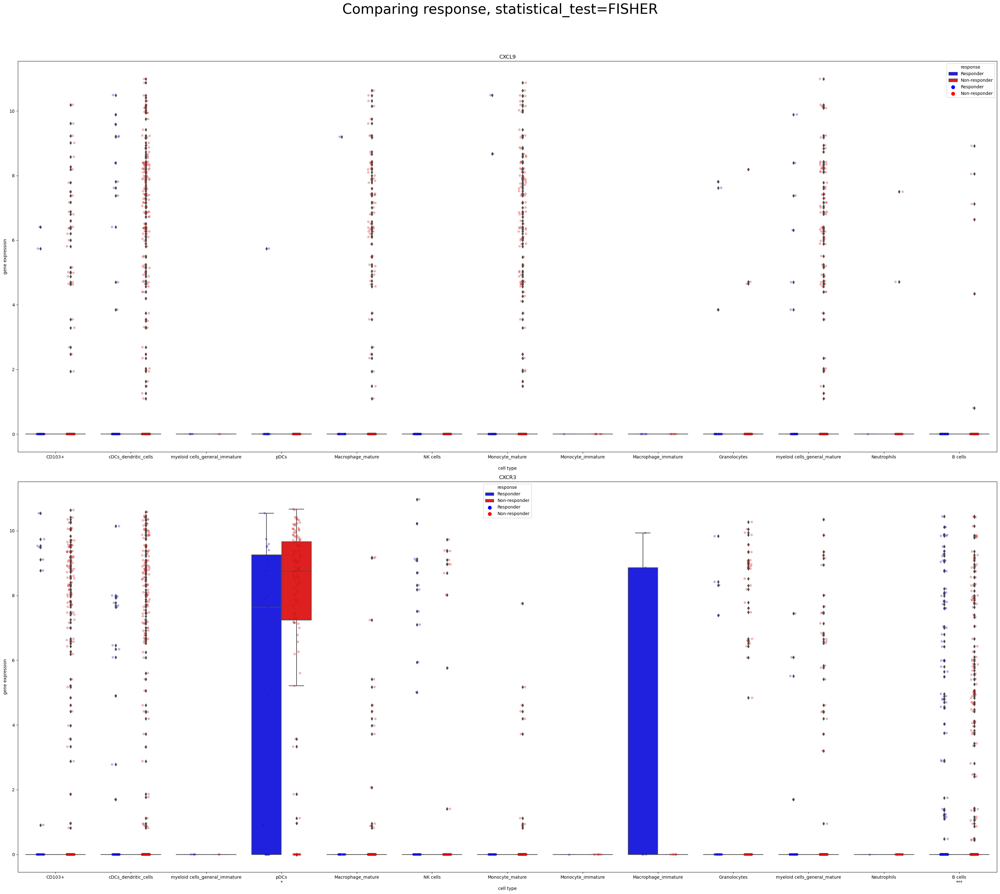

In [145]:
### builds DFs of all genes X cell types and conduct Z test:
df_gene_list = {}
genes = ['CXCL9','CXCR3']
for gene_idx, gene in enumerate(genes):
    g_cohort = filtered_cohort[:,  filtered_cohort.var['gene']==gene]
    f_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', FEATURE])
    df_gene_list[gene] = []
    for idx, cell_type in enumerate(CELL_TYPES):
        indices = [cell_type in ttt for ttt in g_cohort.obs['cell_type']]
        fg_cohort = g_cohort[indices, :]
        gene_exps = fg_cohort.X[:,0].tolist()
        feature_values = fg_cohort.obs[FEATURE].tolist()
        barcodes = fg_cohort.obs['barcode'].tolist()
        samples = fg_cohort.obs['sample'].tolist()

        ### statistical test of gene expression R/NR
        res_df = pd.DataFrame(transpose_list([samples, feature_values, gene_exps]), columns=['sample', FEATURE, 'exp'])
        pvalue = stat_test(res_df, FEATURE, gene, cell_type)
    
        df_gene_list[gene].append([pd.DataFrame(np.array([barcodes, gene_exps, [cell_type]*fg_cohort.shape[0], feature_values]).T, columns=f_df.columns), pvalue])
        
fig, axs = plt.subplots(len(genes))
fig.set_size_inches(32, 30)

### Correct pvals of all [genes X cell_types]
corrected_pvals = multipletests_fdr(np.array([pp[1]for ct_dfs in df_gene_list.values() for pp in ct_dfs ]))[1].reshape(len(genes), len(CELL_TYPES))

### For each gene prints all cell types:
my_pal = {"Responder": "b", "Non-responder": "r", "Pre":"r", "Post":"b"}
for gene_idx, gene in enumerate(genes):
    print_df = pd.DataFrame(columns=['barcode', 'gene expression', 'cell type', FEATURE])
    for cell_idx, cell_type in enumerate(CELL_TYPES):
        cell_type_df = df_gene_list[gene][cell_idx][0]
        prev_pval = df_gene_list[gene][cell_idx][1]
        corrected_pval = corrected_pvals[gene_idx][cell_idx]
        cell_type_df['cell type'] = cell_type_df['cell type'].iloc[0]+'\n'+ get_pval_symbol(corrected_pval)
        print_df = print_df.append(cell_type_df)

    print_df['gene expression'] = print_df['gene expression'].astype(float)
    g = sns.boxplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue=FEATURE, data=print_df, palette=my_pal).set(title=gene)
    sns.stripplot(ax=axs[gene_idx], x='cell type', y='gene expression', hue=FEATURE, data=print_df,
              jitter=True, dodge=True, alpha=0.3,linewidth=0.5, palette=my_pal);

if filter_type:
    fig.suptitle(f'Comparing {FEATURE}, only \'{filter_feature_req_value}\' samples were taken, statistical_test={TEST_NAME}', fontsize=32)
else:
    fig.suptitle(f'Comparing {FEATURE}, statistical_test={TEST_NAME}', fontsize=32)
fig.tight_layout(rect=[0, 0.03, 1, 0.95])

# sns.stripplot(alpha=0.3, jitter=0.2, color='k');